In [7]:
'''
Imports
'''

from IPython.display import display
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import os
import shutil

from scipy import stats
from scipy.signal import butter, lfilter, freqz

#import tensorflow as tf
#import keras

import wfdb
from wfdb import processing
import re

'''
NEW package: http://biosppy.readthedocs.io/en/stable/index.html
'''
import biosppy

In [4]:
'''
set dir
'''

cd tmp_dl_dir/

[WinError 2] The system cannot find the file specified: 'tmp_dl_dir/'
C:\Users\Ernest_Glukhov\Documents\BIOHACK\tmp_dl_dir


In [195]:
'''
IMPORT DATA USING WHOLE DATABASE

File RECORDS you can download with database. It contains all names of records for particular database.

You can set max number of record by commented part below
'''

#set the name of patient
pat = []

with open('RECORDS') as inf:

    sig = list()
    fds = list()
    a = 0
    
    for s in inf:
        #regexp for collecting patient_id
        pat.append(int(re.match(r'patient(\d*)', s).group(1)))
        sign, fdss = wfdb.io.rdsamp(s.strip(), channels = [0, 2])
        print(sign.shape)

        sig.append(sign)
        fds.append(fdss)
        
'''     a += 1
        print("{} out of {} imported".format(a, 594))
        if a >= 50:
            break
'''

(38400, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115174, 2)
(115174, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115174, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(32000, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(32000, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(87910, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200, 2)
(115200,

'        a += 1\n        print("{} out of {} imported".format(a, 594))\n        if a >= 50:\n            break'

In [196]:
'''
FILTER OUTLYING RPEAKS

Return indices of correct templates which should be applied to the list of ecg objects as:

info_list = list(map(lambda x: biosppy.signals.ecg.ecg(signal=x[:,0]), sig))

filtered = filter_rpeaks(info_list)

info_list[i]['templates'][filtered[i]] # returns correct templates for i-th observation in sig

info_list[i]['rpeaks'][filtered[i]] # returns correct rpeaks for i-th observation in sig
'''



def filter_euclidean(array):
    return np.argwhere(abs(array-np.mean(array)) < 2*np.std(array))

def filter_rpeaks(ecg_object_list):
    correct_peaks = []
    for ecg_obj in ecg_object_list:
        correct_peaks.append(filter_euclidean(ecg_obj['rpeaks']))
    return correct_peaks

In [247]:
'''
1. Collecting FIRST channel signals from all records to sig.
2. Filter Rpeaks.

You can change show parameter to True and see a report (ECG summary) for every record (before filtering).
'''


info_list = list(map(lambda x: biosppy.signals.ecg.ecg(signal=x[:,0], show=False), sig))
filtered = filter_rpeaks(info_list)


#info_list[i]['templates'][filtered[i]] # returns correct templates for i-th observation in sig
#info_list[i]['rpeaks'][filtered[i]] # returns correct rpeaks for i-th observation in sig

In [248]:
'''
1. Collecting THIRD channel signals from all records to sig.
2. Filter Rpeaks.

You can change show parameter to True and see a report (ECG summary) for every record (before filtering).
'''

info_list_1 = list(map(lambda x: biosppy.signals.ecg.ecg(signal=x[:,1], show=False), sig))
filtered_1 = filter_rpeaks(info_list)

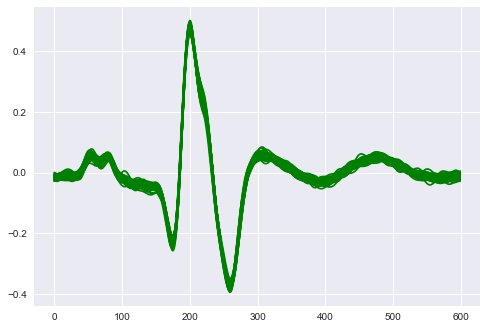

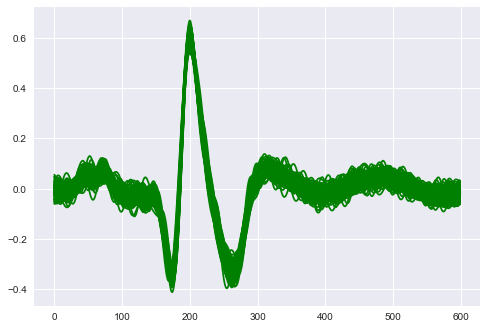

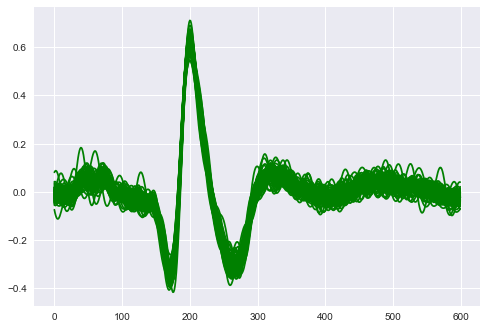

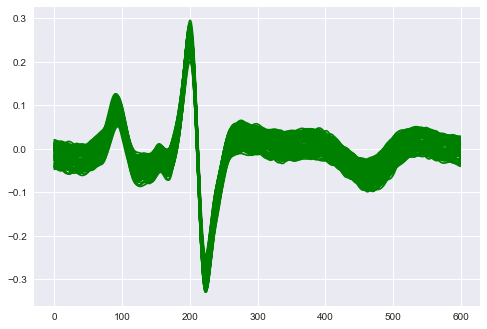

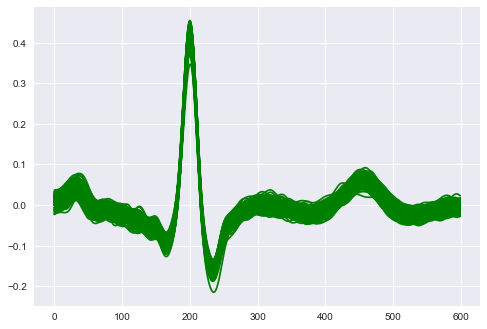

...

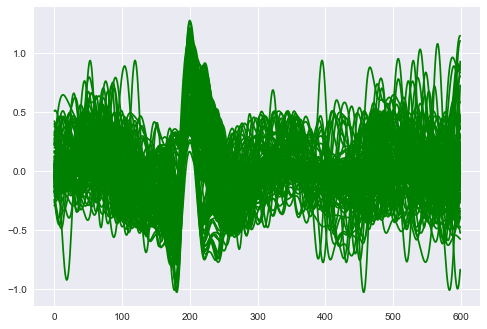

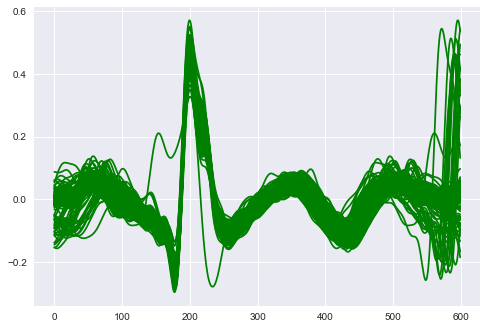

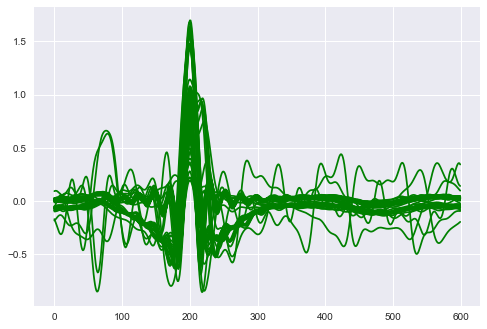

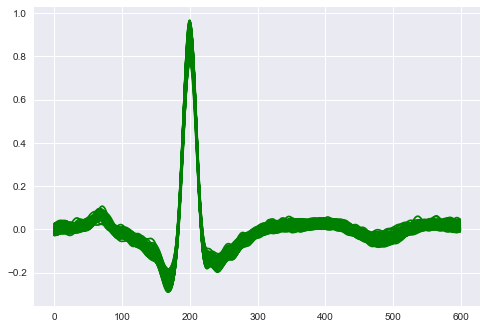

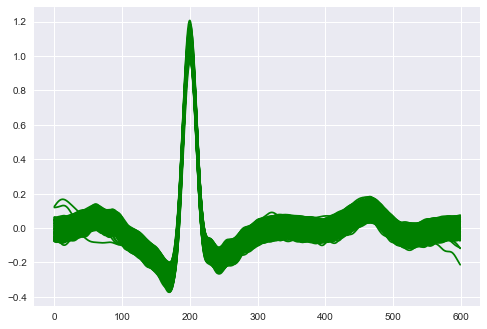

73766


In [274]:
'''
Display ECG templates - first chanell before filtering
'''

count = 0
for j in range(len(info_list)):
    for i in range(len(info_list[j]['templates'])):
        plt.plot(info_list[j]['templates'][i], '-g')
        count +=1
    plt.show()
print(count)

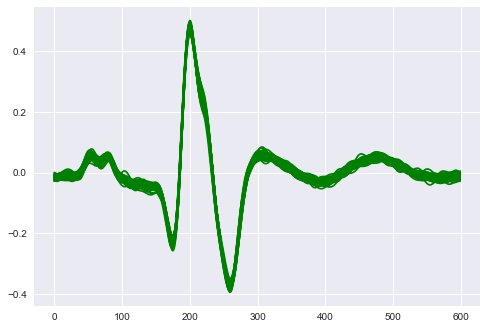

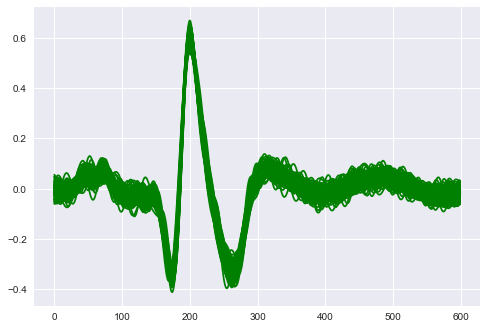

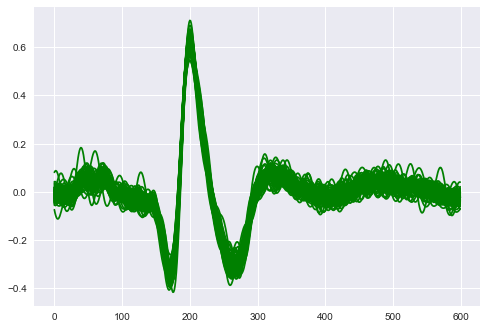

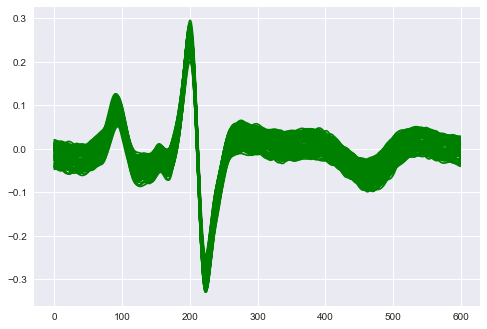

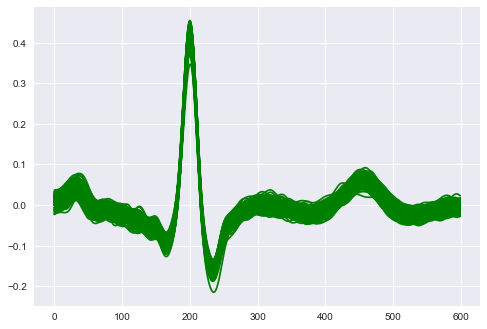

...

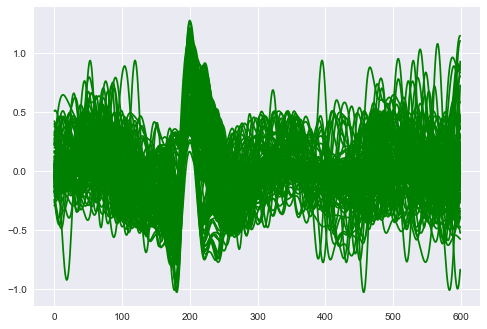

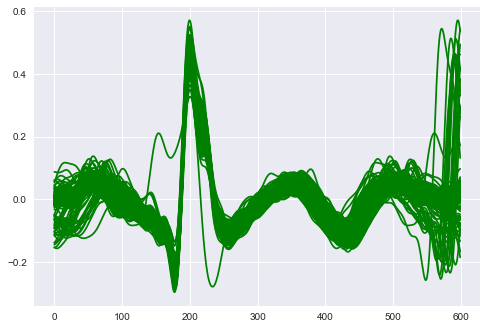

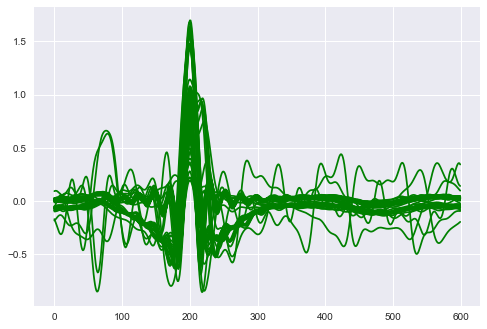

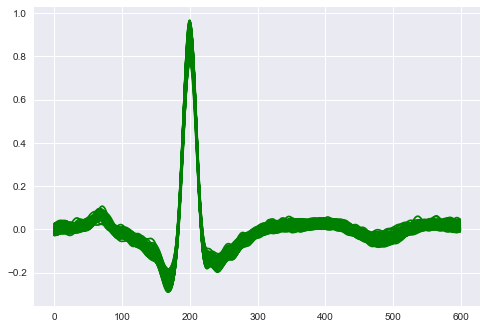

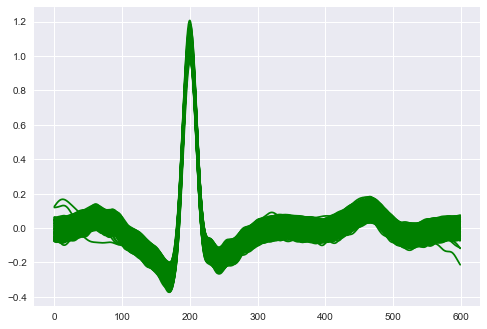

73766


In [275]:
'''
Display ECG templates - first chanell after filtering
'''

count = 0
for j in range(len(info_list)):
    for i in range(len(info_list[j]['templates'][filtered[j]][:,0])):
        plt.plot(info_list[j]['templates'][filtered[j]][:,0][i], '-g')
        count +=1
    plt.show()
print(count)

In [199]:
'''
Define Rpeaks in record and cycle len

Example:
lc = cycle_len(1000, rpeaks)
'''


def cycle_len(y):
    len_cycle = []
    for i in range(int(len(y)-1)):
        len_cycle.append(y[i+1]-y[i])
    lc = int(np.median(len_cycle))
    return lc

In [286]:
'''
Define peaks in TEMPLATES
'''

def peaks_der(data, radius=500, small_window=120):
    der = np.diff(data)
    local_der_maxs = wfdb.processing.find_local_peaks(sig=der, radius=radius)[0]
    local_der_maxs = local_der_maxs[local_der_maxs > small_window]
    local_maxs = np.array(list(map(lambda x: np.argmax(data[x-small_window:x+small_window])+x-small_window, 
                     local_der_maxs)))[0]
    local_qs = np.array(list(map(lambda x: np.argmin(data[x-small_window:x])+x-small_window, 
                     local_der_maxs)))[0]
    local_ss = np.array(list(map(lambda x: np.argmin(data[x:x+small_window])+x, 
                     local_der_maxs)))[0]
    result = [local_maxs, local_qs, local_ss]
    return result

In [287]:
'''
|||12 PARAMS|||
Create data for processing

Display ECG templates before bootstrap?? Use commented lines below.
'''


label = []
total = []

for i, item in enumerate(info_list):
    rp = item['rpeaks'][filtered[i]][:,0]
    lc = cycle_len(rp)
    
    #need to eliminate notes without third channel 
    try:
        len(info_list_1[i]['templates'][filtered[i]][:,0])
    except IndexError:
        continue
    
    for j, l in enumerate(item['templates'][filtered[i]][:,0]):
        
        try:
            peaks = peaks_der(l, radius=lc//2, small_window=120)
            r_ind = peaks[0]
            q_ind = peaks[1]
            s_ind = peaks[2]
        except IndexError:
            continue
        
        #k - one template from channel 2, correlated with j number
        
        k = info_list_1[i]['templates'][filtered_1[i]][:,0][j]
        
        
        try:
            peaks_k = peaks_der(k, radius=lc//2, small_window=120)
            r_ind_k = peaks_k[0]
            q_ind_k = peaks_k[1]
            s_ind_k = peaks_k[2]
        except IndexError:
            continue
        
        tot = [float(r_ind), float(l[r_ind]), 
               float(q_ind), float(l[q_ind]), 
               float(s_ind), float(l[s_ind]),
               float(r_ind_k), float(k[r_ind_k]), 
               float(q_ind_k), float(k[q_ind_k]),
               float(s_ind_k), float(k[s_ind_k])]
        
        total.append(tot)
        label.append(pat[i])
'''       
        plt.plot(l, '-g', linewidth=0.05)
        plt.plot(k, '-r', linewidth=0.05)
        plt.plot(r_ind, l[r_ind], 'bo', q_ind, l[q_ind], 'bo', s_ind, l[s_ind], 'bo',
                r_ind_k, k[r_ind_k], 'w^', q_ind_k, k[q_ind_k], 'w^', s_ind_k, k[s_ind_k], 'w^')
    plt.show()


'''

"       \n        plt.plot(l, '-g', linewidth=0.05)\n        plt.plot(k, '-r', linewidth=0.05)\n        plt.plot(r_ind, l[r_ind], 'bo', q_ind, l[q_ind], 'bo', s_ind, l[s_ind], 'bo',\n                r_ind_k, k[r_ind_k], 'w^', q_ind_k, k[q_ind_k], 'w^', s_ind_k, k[s_ind_k], 'w^')\n    plt.show()\n"

In [ ]:
'''
|||9 PARAMS|||
Create data for processing

Display ECG templates before bootstrap?? Use commented lines below.
'''

label = []
total = []

for i, item in enumerate(info_list):
    rp = item['rpeaks'][filtered[i]][:,0]
    lc = cycle_len(rp)
    
    #need to eliminate notes without third channel 
    try:
        len(info_list_1[i]['templates'][filtered[i]][:,0])
    except IndexError:
        continue
    
    for j, l in enumerate(item['templates'][filtered[i]][:,0]):
        
        try:
            peaks = peaks_der(l, radius=lc//2, small_window=120)
            r_ind = peaks[0]
            q_ind = peaks[1]
            s_ind = peaks[2]
        except IndexError:
            continue
        
        #k - one template from channel 2, correlated with j number
        
        k = info_list_1[i]['templates'][filtered_1[i]][:,0][j]
        
        tot = [float(r_ind), float(l[r_ind]), 
               float(q_ind), float(l[q_ind]), 
               float(s_ind), float(l[s_ind]),
               float(k[r_ind]), 
               float(k[q_ind]),
               float(k[s_ind])]
        
        total.append(tot)
        label.append(pat[i])
        
        
'''       
        plt.plot(l, '-g', linewidth=0.05)
        plt.plot(k, '-r', linewidth=0.05)
        plt.plot(r_ind, l[r_ind], 'bo', q_ind, l[q_ind], 'bo', s_ind, l[s_ind], 'bo',
                r_ind, k[r_ind], 'w^', q_ind, k[q_ind], 'w^', s_ind, k[s_ind], 'w^')
    plt.show()


'''

In [289]:
np.shape(total)

(66043, 12)

In [290]:
total = np.array(total)
label = np.array(label)

In [291]:
np.shape(total)

(66043, 12)

In [299]:
'''
ADDING BOOTSTRAP

It is important that labels were ordered!!!
'''



np.random.seed(1)

def get_bootstrap_samples(data, n_samples):
    indices = np.random.randint(0, len(data), n_samples)
    samples = data[indices,:]
    return samples



def gather_boots(data, labels, size=200):
    uniq_lab = list(set(labels))
    
    breaks = np.empty(1, dtype = "int")

    for i in uniq_lab:
        breaks = np.vstack((breaks, np.searchsorted(label, i)))
    
    breaks = np.vstack((breaks, len(label)))
    breaks = np.delete(breaks, 0)

    dd = np.diff(breaks)
    
    boots = np.empty((1,9))
    
    for i, k in enumerate(breaks[:len(breaks)-1]):
        pool = total[k:k+dd[i],:]
        np.random.seed(i)
        sample = get_bootstrap_samples(pool, size)
        boots = np.vstack((boots, sample))
    
    boots = np.delete(boots, 0, 0)
    return boots

def gather_boot_lab(label, size=200):
    uniq_lab = list(set(label))
    
    lab = np.empty((1,1), dtype = 'int')
    for i in uniq_lab:
        lab = np.vstack((lab, np.full((size,1), i)))
        
    lab = np.delete(lab, 0)
    return lab

size = 200

boots = gather_boots(total, label, size)

boot_lab = gather_boot_lab(label, size)

print(boots.shape)
print(boot_lab.shape)

(53600, 12)
(53600,)


In [300]:
total = boots
label = boot_lab

In [309]:
np.shape(total)

(53600, 12)

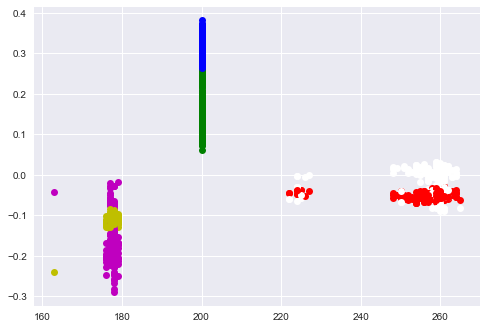

In [237]:
for i in range(len(total)):
    
    #patient = label[i]
    if label[i]==8:
        plt.plot(total[i,0], total[i,1], 'bo', total[i,2], total[i,3], 'yo', total[i,4], total[i,5], 'ro',
                total[i,0], total[i,6], 'g^', total[i,2], total[i,7], 'm^', total[i,4], total[i,8], 'w^')

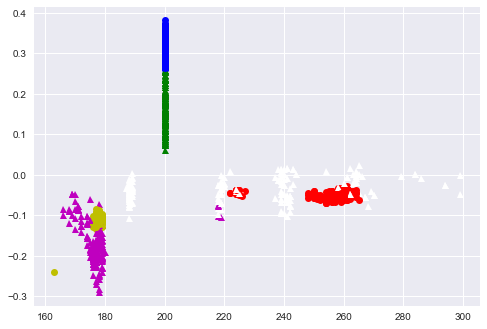

In [302]:
'''
FOR 12 params

'''
for i in range(len(total)):
    
    #patient = label[i]
    if label[i]==8:
        plt.plot(total[i,0], total[i,1], 'bo', total[i,2], total[i,3], 'yo', total[i,4], total[i,5], 'ro',
                total[i,6], total[i,7], 'g^', total[i,8], total[i,9], 'm^', total[i,10], total[i,11], 'w^')


In [303]:
'''
SAVING DATA
'''


np.savetxt("totalX.txt", total, delimiter = '\t')
np.savetxt("label.txt", label, delimiter = '\t')

In [ ]:
'''
UPLOADING  data
'''


total = np.loadtxt(fname="totalX.txt")

label = np.loadtxt(fname="label.txt")

label = np.array(list(map(int, label)))

In [228]:
from sklearn.tree import DecisionTreeClassifier


In [229]:
from sklearn.cross_validation import train_test_split
from sklearn.ensemble import RandomForestClassifier

Xtrain, Xtest, ytrain, ytest = train_test_split(total, label,
                                                random_state=0)
model = RandomForestClassifier(n_estimators=1000)
model.fit(Xtrain, ytrain)
ypred = model.predict(Xtest)

MemoryError: 

In [230]:
from sklearn import metrics
print(metrics.classification_report(ypred, ytest))

ValueError: Found input variables with inconsistent numbers of samples: [1471, 13400]

# Gaussian Mixture Models

In [304]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

In [305]:
from sklearn.metrics import accuracy_score
from sklearn.cross_validation import train_test_split

In [306]:
Xtrain, Xtest, ytrain, ytest = train_test_split(total, label, random_state=0)

In [307]:
from sklearn.naive_bayes import GaussianNB
model = GaussianNB()
model.fit(Xtrain, ytrain)
y_model = model.predict(Xtest)

In [310]:
from sklearn.metrics import accuracy_score
accuracy_score(ytest, y_model)

0.9136567164179105

In [ ]:
from __future__ import print_function

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.svm import SVC

print(__doc__)

n_samples = len(total)

# Split the dataset in two equal parts
X_train, X_test, y_train, y_test = train_test_split(
    total, label, test_size=0.5, random_state=0)

# Set the parameters by cross-validation
tuned_parameters = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-4],
                     'C': [1, 10, 100, 1000]},
                    {'kernel': ['linear'], 'C': [1, 10, 100, 1000]}]

scores = ['precision', 'recall']

for score in scores:
    print("# Tuning hyper-parameters for %s" % score)
    print()

    clf = GridSearchCV(SVC(), tuned_parameters, cv=5,
                       scoring='%s_macro' % score)
    clf.fit(X_train, y_train)

    print("Best parameters set found on development set:")
    print()
    print(clf.best_params_)
    print()
    print("Grid scores on development set:")
    print()
    means = clf.cv_results_['mean_test_score']
    stds = clf.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, clf.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for %r"
              % (mean, std * 2, params))
    print()

    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()
    y_true, y_pred = y_test, clf.predict(X_test)
    print(classification_report(y_true, y_pred))
    print()

# Note the problem is too easy: the hyperparameter plateau is too flat and the
# output model is the same for precision and recall with ties in quality.

### Logistic Regression

In [312]:
import numpy as np
from sklearn import linear_model
clf = linear_model.SGDClassifier()
clf.fit(total, label)
clf.score(total, label, sample_weight=None)

0.030055970149253732

In [313]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from patsy import dmatrices
from sklearn.linear_model import LogisticRegression
from sklearn.cross_validation import train_test_split
from sklearn import metrics
from sklearn.cross_validation import cross_val_score

In [314]:
# instantiate a logistic regression model, and fit with X and y
model = LogisticRegression()
model = model.fit(total, label)

# check the accuracy on the training set
model.score(total, label)

0.792910447761194

In [315]:
# evaluate the model by splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(total, label, test_size=0.3, random_state=0)
model2 = LogisticRegression()
model2.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

In [316]:
# predict class labels for the test set
predicted = model2.predict(X_test)

In [317]:
# generate class probabilities
probs = model2.predict_proba(X_test)

In [318]:
# generate evaluation metrics
print(metrics.accuracy_score(y_test, predicted))
#print(metrics.roc_auc_score(y_test, probs[:, 1]))

0.770957711442786


In [319]:
print (metrics.confusion_matrix(y_test, predicted))
print (metrics.classification_report(y_test, predicted))

[[48  0  0 ...  0  0  0]
 [ 0 62  0 ...  0  0  0]
 [ 0  0 65 ...  0  0  0]
 ...
 [ 0  0  0 ... 68  0  0]
 [ 0  0  0 ...  0 19  0]
 [ 0  0  0 ...  0  0 46]]
             precision    recall  f1-score   support

          1       0.98      1.00      0.99        48
          2       0.81      0.97      0.88        64
          3       0.98      1.00      0.99        65
          4       0.86      0.46      0.60        70
          5       0.61      0.41      0.49        56
          6       0.72      0.83      0.77        53
          7       0.67      0.90      0.77        49
          8       0.84      0.88      0.86        66
          9       0.76      0.95      0.84        57
         10       0.94      0.76      0.84        59
         11       0.53      0.93      0.67        54
         12       1.00      0.82      0.90        66
         14       1.00      0.67      0.80        64
         15       0.64      0.41      0.50        70
         16       0.50      0.71      0.59      

C:\Program Files\Anaconda\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [320]:
res = biosppy.signals.ecg.ecg(signal=y, sampling_rate=1000.0)
rpeaks = res['rpeaks']

ValueError: The length of the input vector x must be at least padlen, which is 903.

In [ ]:
'''
Display using template and all QRS-dots
'''

for i in range(len(res['templates'])):
    plt.plot(res['templates'][i], '-y', linewidth=0.1)
plt.plot(r_ind_arr, r_p_arr, 'ro', q_ind_arr, q_p_arr, 'bo', s_ind_arr, s_p_arr, 'go',)
plt.show()